                           rain_1h
dt                                
2019-10-01 00:00:00+00:00     0.00
2019-10-01 01:00:00+00:00     0.00
2019-10-01 02:00:00+00:00     0.00
2019-10-01 03:00:00+00:00     0.00
2019-10-01 04:00:00+00:00     0.00
2019-10-01 05:00:00+00:00     0.25
2019-10-01 06:00:00+00:00     0.43
2019-10-01 07:00:00+00:00     0.25
2019-10-01 08:00:00+00:00     1.14
2019-10-01 09:00:00+00:00     1.15
2019-10-01 10:00:00+00:00     1.27
2019-10-01 11:00:00+00:00     0.25
2019-10-01 12:00:00+00:00     1.53
2019-10-01 13:00:00+00:00     0.25
2019-10-01 14:00:00+00:00     2.92
2019-10-01 15:00:00+00:00     0.51
2019-10-01 16:00:00+00:00     0.00
2019-10-01 17:00:00+00:00     0.00
2019-10-01 18:00:00+00:00     0.38
2019-10-01 19:00:00+00:00     0.51
2019-10-01 20:00:00+00:00     0.00
2019-10-01 21:00:00+00:00     0.00
2019-10-01 22:00:00+00:00     0.00
2019-10-01 23:00:00+00:00     0.00
2019-10-02 00:00:00+00:00     0.00
2019-10-02 01:00:00+00:00     0.00
2019-10-02 02:00:00+

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


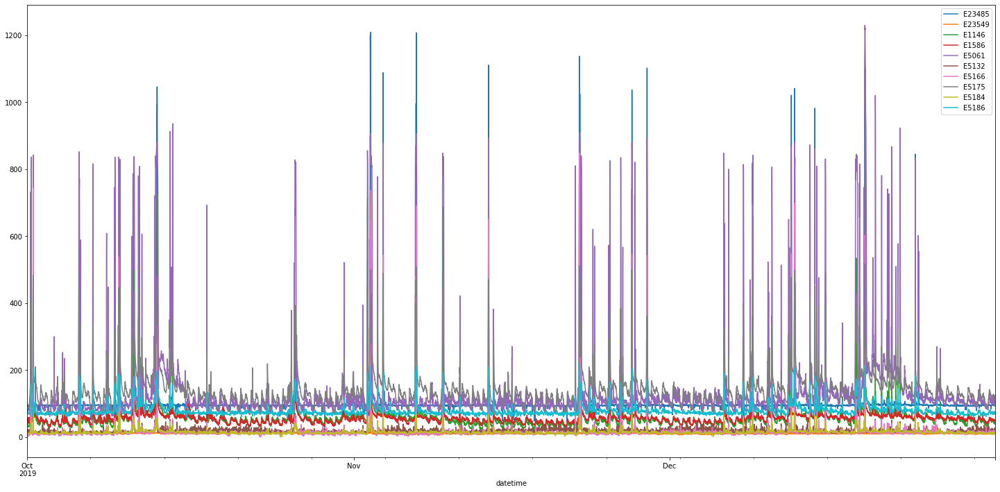

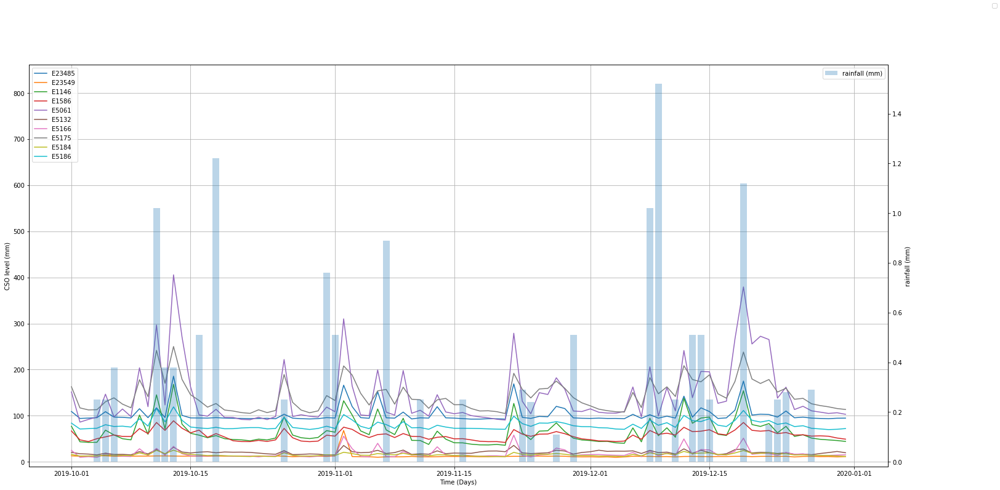

In [5]:

from cProfile import label
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
import mpl_axes_aligner
#from scipy.signal import lfilter
import seaborn as sns
#from IPython.display import display

path_rainfall = r'C:\Users\Melch\OneDrive\Documents\data_vis_exercise\rainfall.csv' #path to rainfall csv file
path_cso_level_monitors = r'C:\Users\Melch\OneDrive\Documents\data_vis_exercise\cso_level_monitors.csv' #path to cso level monitor csv file
#set a datetimeindex and  csv --> dataframe
df_rainfall = pd.read_csv(path_rainfall, parse_dates=['dt'], index_col='dt')

print(df_rainfall)
#plt.show()
df_cso_level_indicators = pd.read_csv(path_cso_level_monitors, parse_dates=['datetime'], index_col='datetime')

df_cso_level_indicators_resample=df_cso_level_indicators[df_cso_level_indicators.columns[0:10]].resample('D').mean()

df_cso_level_indicators_resample2=df_cso_level_indicators[df_cso_level_indicators.columns[0:10]].resample('15min').mean()
#plot1
df_cso_level_indicators_resample2.plot(figsize=(25, 12))

##########

df_cso_level_indicators_resample["rain_1h"] = df_rainfall.rain_1h

# removing Missing Values
df_cso_level_indicators_resample.dropna(inplace=True)

#dual plot

fig, ax1 = plt.subplots()
fig.set_size_inches(25,12)
fig.legend()
ax2 = ax1.twinx()

ax1.plot(df_cso_level_indicators_resample.index.date, df_cso_level_indicators_resample[df_cso_level_indicators_resample.columns[0:10]], label=df_cso_level_indicators_resample.columns[0:10].to_list())
ax1.legend(loc='upper left')

ax2.bar(df_cso_level_indicators_resample.index.date, df_cso_level_indicators_resample['rain_1h'], alpha= 0.3, label='rainfall (mm)')
ax2.legend(loc='upper right')
ax1.grid()
ax1.set_xlabel("Time (Days)")
ax1.set_ylabel('CSO level (mm)')
ax2.set_ylabel('rainfall (mm)')
mpl_axes_aligner.align.yaxes(ax1, 0, ax2, 0)

plt.show()
#df_cso_level_indicators_resample



In [7]:

path_cso_info = r'C:\Users\Melch\OneDrive\Documents\data_vis_exercise\cso_info.csv' #p
df_cso_info = pd.read_csv(path_cso_info)
#print(df_cso_info)

#to display max rows in each dataframe
pd.set_option("display.max_rows", None, "display.max_columns", None)

df_spill_event_tracker = df_cso_level_indicators
#print(df_spill_event_tracker[df_cso_level_indicators.columns])
c=[]
d=[]
durationList=[]
durCalc=[]

# to iterate over data from all cso indicators and indicate the start and end of a spill event
for e_num in df_cso_level_indicators.columns.to_list()[0:-1]:
    #to check e_num iterator
    #print(e_num) 

    #"changed" column to notice an event where a spill event starts
    # df_cso_info.loc[df_cso_info.e_number == e_num, 'spill_level_mm'].iloc[0] --> this references the spill level threshold that starts a spill event
    df_spill_event_tracker['changed'] = (df_spill_event_tracker[e_num] > df_cso_info.loc[df_cso_info.e_number == e_num, 'spill_level_mm'].iloc[0]).astype(int).diff().fillna(1).astype(int)

    # sets a 1 or -1 fort the start and end of a spill events
    print(df_spill_event_tracker['changed'])
    a = pd.DataFrame({
        't_0_'+e_num: df_spill_event_tracker.index[df_spill_event_tracker.changed ==  1]}).reset_index()

    b = pd.DataFrame({
        't_n_'+e_num: df_spill_event_tracker.index[df_spill_event_tracker.changed ==  -1]}).reset_index()

    #creation of a dataframe that records time at start anld end of spill and calculates duration in seconds
    c = pd.concat([a,b.shift(1)], axis =1)
    c['duration(min)_'+e_num]=c['t_n_'+e_num]-c['t_0_'+e_num] 
    c['duration(min)_'+e_num]=c['duration(min)_'+e_num].dt.total_seconds()/60
    
    #list that adds duration dataframe to it with every iteration
    durationList.append(c)
    #list to store number of duration events, this is the c.shape[0] input
    d.append(c.shape[0])
    #print(c) to check output of c
    durCalc.append(c['duration(min)_'+e_num])
    #spill frequency table, a dataframe to store all event durations
spill_frequency_table = pd.DataFrame(d)
spill_frequency_table = spill_frequency_table.transpose()
spill_frequency_table.columns = df_cso_level_indicators.columns[0:-1]
spill_frequency_table
c

print(durationList)
#create loop to create tables for each spill duration


E23485
datetime
2019-10-01 00:00:00+00:00    1
2019-10-01 00:15:00+00:00    0
2019-10-01 00:30:00+00:00    0
2019-10-01 00:45:00+00:00    0
2019-10-01 01:00:00+00:00    0
2019-10-01 01:15:00+00:00    0
2019-10-01 01:30:00+00:00    0
2019-10-01 01:45:00+00:00    0
2019-10-01 02:00:00+00:00    0
2019-10-01 02:15:00+00:00    0
2019-10-01 02:30:00+00:00    0
2019-10-01 02:45:00+00:00    0
2019-10-01 03:00:00+00:00    0
2019-10-01 03:15:00+00:00    0
2019-10-01 03:30:00+00:00    0
2019-10-01 03:45:00+00:00    0
2019-10-01 04:00:00+00:00    0
2019-10-01 04:15:00+00:00    0
2019-10-01 04:30:00+00:00    0
2019-10-01 04:45:00+00:00    0
2019-10-01 05:00:00+00:00    0
2019-10-01 05:15:00+00:00    0
2019-10-01 05:30:00+00:00    0
2019-10-01 05:45:00+00:00    0
2019-10-01 06:00:00+00:00    0
2019-10-01 06:15:00+00:00    0
2019-10-01 06:30:00+00:00    0
2019-10-01 06:45:00+00:00    0
2019-10-01 07:00:00+00:00    0
2019-10-01 07:15:00+00:00    0
2019-10-01 07:30:00+00:00    0
2019-10-01 07:45:00+00:

In [11]:
#df_durationList = pd.DataFrame(durationList[0]).sum()
#to calculate average spill length and number of spills
df_durCalc=pd.DataFrame(durCalc)
df_durCalc.reset_index()
sum =df_durCalc.sum(skipna=True)
totalSum =sum.sum()
totalSum.mean()
df_cso_level_indicators.columns[0:-1]

Index(['E23485', 'E23549', 'E1146', 'E1586', 'E5061', 'E5132', 'E5166',
       'E5175', 'E5184', 'E5186'],
      dtype='object')

In [12]:
df_durCalc.mean().mean()
df_durCalc.count()

0      0
1      8
2      7
3      7
4      7
5      7
6      7
7      7
8      7
9      7
10     7
11     7
12     6
13     6
14     6
15     6
16     6
17     5
18     5
19     5
20     5
21     5
22     5
23     5
24     5
25     5
26     5
27     5
28     5
29     5
30     5
31     5
32     5
33     5
34     5
35     5
36     5
37     5
38     5
39     5
40     5
41     5
42     5
43     5
44     4
45     4
46     4
47     4
48     4
49     3
50     3
51     3
52     3
53     3
54     3
55     3
56     3
57     3
58     3
59     3
60     3
61     3
62     3
63     3
64     3
65     3
66     3
67     3
68     3
69     3
70     3
71     3
72     3
73     2
74     1
75     1
76     1
77     1
78     1
79     1
80     1
81     1
82     1
83     1
84     1
85     1
86     1
87     1
88     1
89     1
90     1
91     1
92     1
93     1
94     1
95     1
96     1
97     1
98     1
99     1
100    1
101    1
102    1
103    1
104    1
105    1
106    1
107    1
108    1
109    1
110    1
1

Index(['E23485', 'E23549', 'E1146', 'E1586', 'E5061', 'E5132', 'E5166',
       'E5175', 'E5184', 'E5186'],
      dtype='object')

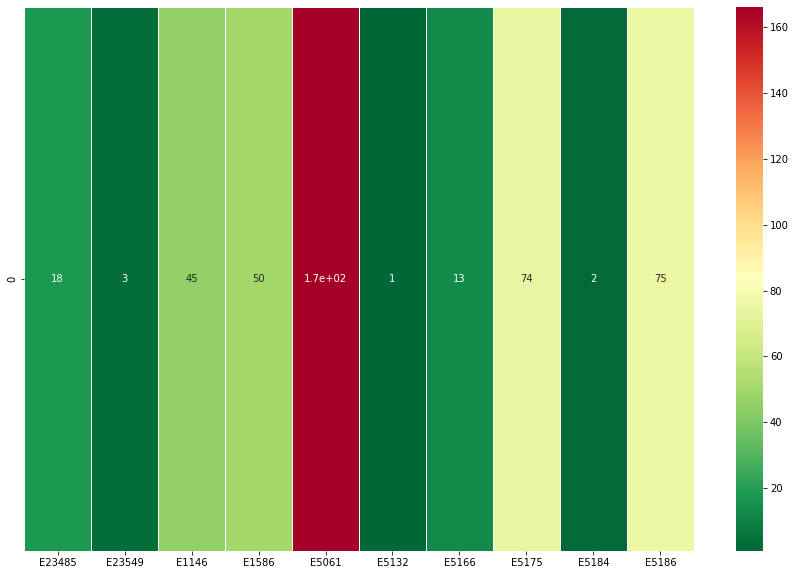

In [13]:
#to plot heatmap
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(spill_frequency_table, cmap='RdYlGn_r', linewidths=0.5, annot=True)
spill_frequency_table.columns